# NER Before COVID

## Merging Comments and Submission in a proper format

In [2]:
import pandas as pd
a = pd.read_csv("Green-comments-before2020.csv")
b = pd.read_csv("sustainability-comments-before2020.csv")

In [3]:
merged = pd.concat([a,b],ignore_index=True)
merged.head()

,id,submission_id,body,created_utc,parent_id,permalink
0,ffbxc48,ess8fe,"An alternative economic model is needed, but N...",1579785808,t3_ess8fe,/r/Green/comments/ess8fe/prince_charles_we_nee...
1,ffc5i6h,ess8fe,\*splutters tea everywhere\* The dude _owns_ t...,1579792001,t3_ess8fe,/r/Green/comments/ess8fe/prince_charles_we_nee...
2,ff8z7yf,esc09d,This is garbage.\n\nHalf of these aren't even ...,1579700709,t3_esc09d,/r/Green/comments/esc09d/did_you_know_all_of_t...
3,ff8znss,esc09d,"Hello, thank you for your comment. \nI am myse...",1579701058,t1_ff8z7yf,/r/Green/comments/esc09d/did_you_know_all_of_t...
4,ff8i5we,es722y,It sounds great using wood and wooden building...,1579679578,t3_es722y,/r/Green/comments/es722y/the_hottest_new_thing...


In [4]:
df = pd.DataFrame(merged, columns = ["id", "body"])

In [4]:
df.shape

(22466, 2)

In [5]:
df.head()

,id,body
0,ffbxc48,"An alternative economic model is needed, but N..."
1,ffc5i6h,\*splutters tea everywhere\* The dude _owns_ t...
2,ff8z7yf,This is garbage.\n\nHalf of these aren't even ...
3,ff8znss,"Hello, thank you for your comment. \nI am myse..."
4,ff8i5we,It sounds great using wood and wooden building...


In [6]:
df = df.rename(columns={'body': 'content'})

In [7]:
df.head()

,id,content
0,ffbxc48,"An alternative economic model is needed, but N..."
1,ffc5i6h,\*splutters tea everywhere\* The dude _owns_ t...
2,ff8z7yf,This is garbage.\n\nHalf of these aren't even ...
3,ff8znss,"Hello, thank you for your comment. \nI am myse..."
4,ff8i5we,It sounds great using wood and wooden building...


In [8]:
c = pd.read_csv("Green-submission-before2020.csv")
d = pd.read_csv("sustainability-submission-before2020.csv")

In [9]:
merged2 = pd.concat([c,d],ignore_index=True)
merged2.head()

,id,created_utc,title,selftext,full_link
0,esw9zn,1579800339,AU Brushfire Relief Charity Bundles - Drive Th...,NaN,https://www.reddit.com/r/Green/comments/esw9zn...
1,ess8fe,1579781539,Prince Charles: We need a new economic model o...,NaN,https://www.reddit.com/r/Green/comments/ess8fe...
2,esloit,1579742327,China is moving to phase out single-use plasti...,NaN,https://www.reddit.com/r/Green/comments/esloit...
3,esfx97,1579717268,Microsoft Plans to be Carbon Negative by 2030,NaN,https://www.reddit.com/r/Green/comments/esfx97...
4,escvi1,1579704085,It's not looking good for Big Oil :),NaN,https://www.reddit.com/r/Green/comments/escvi1...


In [10]:
df2 = pd.DataFrame(merged2, columns = ["id","title", "selftext"])
df2.shape

(10773, 3)

In [11]:
import numpy as np
df2['selftext'] = df2['selftext'].replace("[deleted]", "")
df2['selftext'] = df2['selftext'].replace("[removed]", "")
df2['selftext'] = df2['selftext'].replace("<not selftext available>", "")
df2['selftext'] = df2['selftext'].replace(np.nan," ")

In [12]:
df2["content"] = df2["title"] +" "+ df2["selftext"]
df2.head()

,id,title,selftext,content
0,esw9zn,AU Brushfire Relief Charity Bundles - Drive Th...,,AU Brushfire Relief Charity Bundles - Drive Th...
1,ess8fe,Prince Charles: We need a new economic model o...,,Prince Charles: We need a new economic model o...
2,esloit,China is moving to phase out single-use plasti...,,China is moving to phase out single-use plasti...
3,esfx97,Microsoft Plans to be Carbon Negative by 2030,,Microsoft Plans to be Carbon Negative by 2030
4,escvi1,It's not looking good for Big Oil :),,It's not looking good for Big Oil :)


In [13]:
df3 = pd.DataFrame(df2, columns = ["id","content"])

In [14]:
df3.head()

,id,content
0,esw9zn,AU Brushfire Relief Charity Bundles - Drive Th...
1,ess8fe,Prince Charles: We need a new economic model o...
2,esloit,China is moving to phase out single-use plasti...
3,esfx97,Microsoft Plans to be Carbon Negative by 2030
4,escvi1,It's not looking good for Big Oil :)


In [15]:
merged_final = pd.concat([df,df3],ignore_index=True)
print(merged_final.shape)
merged_final.head()

(33239, 2)


,id,content
0,ffbxc48,"An alternative economic model is needed, but N..."
1,ffc5i6h,\*splutters tea everywhere\* The dude _owns_ t...
2,ff8z7yf,This is garbage.\n\nHalf of these aren't even ...
3,ff8znss,"Hello, thank you for your comment. \nI am myse..."
4,ff8i5we,It sounds great using wood and wooden building...


In [16]:
dfx = merged_final.copy()

## Data Cleaning

In [19]:
from pandas_profiling import ProfileReport

In [21]:
profile = ProfileReport(dfx, title="Pandas Profiling Report", explorative=True)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [17]:
dfx.shape

(33239, 2)

In [18]:
df1 = dfx.copy()

In [19]:
df1 = df1.rename(columns={'content':'body'})

In [20]:
df1 = df1.loc[df1["body"] != "[deleted]"]
df1.shape

(32672, 2)

In [21]:
df1 = df1.loc[df1["body"] != "[removed]"]
df1.shape

(32454, 2)

In [22]:
df1 = df1.loc[df1["body"] != "Sorry, your submission has been automatically removed. Account age too young, spam likely.\\n\\n*I am a bot, and this action was performed automatically. Please [contact the moderators of this subreddit](/message/compose/?to=/r/Green) if you have any questions or concerns.*"]
df1.shape

(32109, 2)

In [23]:
df1 = df1.loc[df1["body"] != "Sorry, your submission has been automatically removed. Not enough comment karma, spam likely.\\n\\n*I am a bot, and this action was performed automatically. Please [contact the moderators of this subreddit](/message/compose/?to=/r/Green) if you have any questions or concerns.*"]
df1.shape

(31970, 2)

In [24]:
df1 = df1.loc[df1["body"] != "Thank you!"]
df1.shape

(31951, 2)

In [25]:
df1 = df1.loc[df1["body"] != '!emissionsbot']
df1.shape

(31946, 2)

In [26]:
df1 = df1.loc[df1["body"] != 'Thank you']
df1.shape

(31941, 2)

In [27]:
df1 = df1.loc[df1["body"] != 'Thank you.']
df1.shape

(31936, 2)

In [28]:
df1 = df1.loc[df1["body"] != '/r/careerguidance']
df1.shape

(31928, 2)

In [29]:
df1 = df1.loc[df1["body"] != 'Thanks!']
df1.shape

(31916, 2)

In [30]:
df1 = df1.loc[df1["body"] != 'No']
df1.shape

(31909, 2)

In [31]:
df1 = df1.loc[df1["body"] != 'Lol']
df1.shape

(31905, 2)

In [32]:
df1 = df1.loc[df1["body"] != 'No.']
df1.shape

(31901, 2)

In [33]:
df1 = df1.loc[df1["body"] != 'Source?']
df1.shape

(31897, 2)

In [34]:
df1 = df1.loc[df1["body"] != 'x-post: /r/EnviroNews']
df1.shape

(31893, 2)

In [35]:
df1 = df1.loc[df1["body"] != 'Thank you!!!']
df1.shape

(31889, 2)

In [36]:
df1 = df1.loc[df1["body"] != '?']
df1.shape

(31886, 2)

In [37]:
df1 = df1.loc[df1["body"] != 'Thanks']
df1.shape

(31883, 2)

In [38]:
df1 = df1.loc[df1["body"] != 'Yes']
df1.shape

(31880, 2)

In [39]:
df1 = df1.loc[df1["body"] != 'Yes.']
df1.shape

(31877, 2)

In [40]:
df1 = df1.loc[df1["body"] != 'Thank you!!']
df1.shape

(31874, 2)

In [41]:
df1 = df1.loc[df1["body"] != ':(']
df1.shape

(31871, 2)

In [42]:
df1 = df1.loc[df1["body"] != '/r/Green does not allow image submissions.\\n\\n*I am a bot, and this action was performed automatically. Please [contact the moderators of this subreddit](/message/compose/?to=/r/Green) if you have any questions or concerns.*']
df1.shape

(31800, 2)

In [43]:
df1 = df1.loc[df1["body"] != 'Green  ']
df1.shape

(31792, 2)

In [55]:
profile2 = ProfileReport(df1, title="Pandas Profiling Report", explorative=True)
profile2

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [44]:
df = df1.copy()
df.shape

(31792, 2)

## Text Cleaning

In [45]:
import neattext.functions as nfx

In [46]:
df = df.dropna()

In [47]:
df= df.replace(r'\n',' ', regex=True)

In [48]:
df = df.replace(r'\\n',' ', regex=True)

In [49]:
df = df.replace(r'/r/',' ', regex=True)

In [50]:
df.head()

,id,body
0,ffbxc48,"An alternative economic model is needed, but N..."
1,ffc5i6h,\*splutters tea everywhere\* The dude _owns_ t...
2,ff8z7yf,This is garbage. Half of these aren't even ne...
3,ff8znss,"Hello, thank you for your comment. I am mysel..."
4,ff8i5we,It sounds great using wood and wooden building...


In [51]:
slang_dict = {
"AFAIK": "As Far As I Know",
"AFK": "Away From Keyboard",
"ASAP": "As Soon As Possible",
"ATK": "At The Keyboard",
"ATM": "At The Moment",
"A3": "Anytime, Anywhere, Anyplace",
"BAK": "Back At Keyboard",
"BBL": "Be Back Later",
"BBS": "Be Back Soon",
"BFN": "Bye For Now",
"B4N": "Bye For Now",
"BRB": "Be Right Back",
"BRT": "Be Right There",
"BTW": "By The Way",
"B4": "Before",
"B4N": "Bye For Now",
"CU": "See You",
"CUL8R": "See You Later",
"CYA": "See You",
"FAQ": "Frequently Asked Questions",
"FC": "Fingers Crossed",
"FWIW": "For What It's Worth",
"FYI": "For Your Information",
"GAL": "Get A Life",
"GG": "Good Game",
"GN": "Good Night",
"GMTA": "Great Minds Think Alike",
"GR8": "Great!",
"G9": "Genius",
"OMG": "Surprised",
"IC": "I See",
"ICQ": "I Seek you (also a chat program)",
"ILU": "ILU: I Love You",
"IMHO": "In My Honest / Humble Opinion",
"IMO": "In My Opinion",
"IOW": "In Other Words",
"IRL": "In Real Life",
"KISS": "Keep It Simple, Stupid",
"LDR": "Long Distance Relationship",
"LMAO": "Laugh My Ass Off",
"LOL": "Laughing Out Loud",
"LTNS": "Long Time No See",
"L8R": "Later",
"MTE": "My Thoughts Exactly",
"M8": "Mate",
"NRN": "No Reply Necessary",
"OIC": "Oh I See",
"PITA": "Pain In The Ass",
"PRT": "Party",
"PRW": "Parents Are Watching",
"ROFL": "Rolling On The Floor Laughing",
"ROFLOL": "Rolling On The Floor Laughing Out Loud",
"ROTFLMAO": "Rolling On The Floor Laughing My Ass Off",
"SK8": "Skate",
"STATS": "Your sex and age",
"ASL": "Age, Sex, Location",
"THX": "Thank You",
"TTFN": "Ta-Ta For Now!",
"TTYL": "Talk To You Later",
"U2": "You Too",
"U4E": "Yours For Ever",
"WB": "Welcome Back",
"WTF": "What The Fuck",
"WTG": "Way To Go!",
"WUF": "Where Are You From?",
"W8": "Wait"
}

In [52]:
def slang(x):
    if type(x) is str:
        for key in slang_dict:
            value = slang_dict[key]
            x = x.replace(key,value)
        return x
    else:
        return x

In [53]:
# EXAMPLE
slang("Hey Rishabh BRB !!")

'Hey Rishabh Be Right Back !!'

In [54]:
df["SLANG-ext"] =df["body"].apply(lambda x: slang(x))

In [55]:
contractions_dict = {
"ain't": "am not / are not",
"aren't": "are not / am not",
"can't": "cannot",
"can't've": "cannot have",
"'cause": "because",
"could've": "could have",
"couldn't": "could not",
"couldn't've": "could not have",
"didn't": "did not",
"doesn't": "does not",
"don't": "do not",
"hadn't": "had not",
"hadn't've": "had not have",
"hasn't": "has not",
"haven't": "have not",
"he'd": "he had / he would",
"he'd've": "he would have",
"he'll": "he shall / he will",
"he'll've": "he shall have / he will have",
"he's": "he has / he is",
"how'd": "how did",
"how'd'y": "how do you",
"how'll": "how will",
"how's": "how has / how is",
"here's": "here is",
"i'd": "I had / I would",
"i'd've": "I would have",
"i'll": "I shall / I will",
"i'll've": "I shall have / I will have",
"i'm": "I am",
"i've": "I have",
"isn't": "is not",
"it'd": "it had / it would",
"it'd've": "it would have",
"it'll": "it shall / it will",
"it'll've": "it shall have / it will have",
"it's": "it has / it is",
"let's": "let us",
"ma'am": "madam",
"mayn't": "may not",
"might've": "might have",
"mightn't": "might not",
"mightn't've": "might not have",
"must've": "must have",
"mustn't": "must not",
"mustn't've": "must not have",
"needn't": "need not",
"needn't've": "need not have",
"o'clock": "of the clock",
"oughtn't": "ought not",
"oughtn't've": "ought not have",
"shan't": "shall not",
"sha'n't": "shall not",
"shan't've": "shall not have",
"she'd": "she had / she would",
"she'd've": "she would have",
"she'll": "she shall / she will",
"she'll've": "she shall have / she will have",
"she's": "she has / she is",
"should've": "should have",
"shouldn't": "should not",
"shouldn't've": "should not have",
"so've": "so have",
"so's": "so as / so is",
"that'd": "that would / that had",
"that'd've": "that would have",
"that's": "that has / that is",
"there'd": "there had / there would",
"there'd've": "there would have",
"there's": "there has / there is",
"they'd": "they had / they would",
"they'd've": "they would have",
"they'll": "they shall / they will",
"they'll've": "they shall have / they will have",
"they're": "they are",
"they've": "they have",
"to've": "to have",
"wasn't": "was not",
"we'd": "we had / we would",
"we'd've": "we would have",
"we'll": "we will",
"we'll've": "we will have",
"we're": "we are",
"we've": "we have",
"weren't": "were not",
"what'll": "what shall / what will",
"what'll've": "what shall have / what will have",
"what're": "what are",
"what's": "what has / what is",
"what've": "what have",
"when's": "when has / when is",
"when've": "when have",
"where'd": "where did",
"where's": "where has / where is",
"where've": "where have",
"who'll": "who shall / who will",
"who'll've": "who shall have / who will have",
"who's": "who has / who is",
"who've": "who have",
"why's": "why has / why is",
"why've": "why have",
"will've": "will have",
"won't": "will not",
"won't've": "will not have",
"would've": "would have",
"wouldn't": "would not",
"wouldn't've": "would not have",
"y'all": "you all",
"y'all'd": "you all would",
"y'all'd've": "you all would have",
"y'all're": "you all are",
"y'all've": "you all have",
"you'd": "you had / you would",
"you'd've": "you would have",
"you'll": "you shall / you will",
"you'll've": "you shall have / you will have",
"you're": "you are",
"you've": "you have"
}

In [56]:
def cont_to_exp(x):
    if type(x) is str:
        for key in contractions_dict:
            value = contractions_dict[key]
            x = x.lower().replace(key,value)
        return x
    else:
        return x

In [57]:
# EXAMPLE
cont_to_exp("what's the best way to ensure this?")

'what has / what is the best way to ensure this?'

In [58]:
df["Cont-Exp"] =df["SLANG-ext"].apply(lambda x: cont_to_exp(x))

In [59]:
def preprocess(df):
    
    df= df.apply(nfx.remove_urls)
    df= df.apply(nfx.remove_special_characters)
    df= df.apply(nfx.remove_emojis)
    df= df.apply(nfx.remove_numbers)
    df= df.apply(nfx.remove_puncts)
    df= df.apply(nfx.remove_hashtags)
    df= df.apply(nfx.remove_currencies)
    df= df.apply(lambda x: x.lower())
    df= df.apply(nfx.remove_multiple_spaces)
    df= df.apply(nfx.remove_stopwords)
    
    return df

In [60]:
df["final"] =[each for each in preprocess(df["Cont-Exp"])]
df.head()

,id,body,SLANG-ext,Cont-Exp,final
0,ffbxc48,"An alternative economic model is needed, but N...","An alternative economic model is needed, but N...","an alternative economic model is needed, but n...",alternative economic model needed native ameri...
1,ffc5i6h,\*splutters tea everywhere\* The dude _owns_ t...,\*splutters tea everywhere\* The dude _owns_ t...,\*splutters tea everywhere\* the dude _owns_ t...,splutters tea dude owns duchy cornwall sure he...
2,ff8z7yf,This is garbage. Half of these aren't even ne...,This is garbage. Half of these aren't even ne...,this is garbage. half of these are not / am n...,garbage half necessarily correct spell hair co...
3,ff8znss,"Hello, thank you for your comment. I am mysel...","Hello, thank you for your comment. I am mysel...","hello, thank you for your comment. i am mysel...",hello thank comment dedicated learn strive eco...
4,ff8i5we,It sounds great using wood and wooden building...,It sounds great using wood and wooden building...,it sounds great using wood and wooden building...,sounds great wood wooden buildings look nice d...


In [61]:
new = pd.DataFrame(df, columns = ["id","final"])

In [62]:
new.head()

,id,final
0,ffbxc48,alternative economic model needed native ameri...
1,ffc5i6h,splutters tea dude owns duchy cornwall sure he...
2,ff8z7yf,garbage half necessarily correct spell hair co...
3,ff8znss,hello thank comment dedicated learn strive eco...
4,ff8i5we,sounds great wood wooden buildings look nice d...


In [63]:
#export to csv
new.to_csv( "Clean_Data_Before_Covid.csv", index=False, encoding='utf-8-sig')

In [5]:
import pandas as pd
new = pd.read_csv("Clean_Data_Before_Covid.csv")
print(new.shape)
new.head()

(31790, 2)


,id,final
0,ffbxc48,alternative economic model needed native ameri...
1,ffc5i6h,splutters tea dude owns duchy cornwall sure he...
2,ff8z7yf,garbage half necessarily correct spell hair co...
3,ff8znss,hello thank comment dedicated learn strive eco...
4,ff8i5we,sounds great wood wooden buildings look nice d...


## Named Entity Recognition

### A) SPACY

In [138]:
import spacy

nlp = spacy.load("en_core_web_sm")

In [139]:
def ner(text):
    doc=nlp(text)
    return [X.label_ for X in doc.ents]

In [141]:
ent=new["final"].apply(lambda x : ner(x))

ent=[x for sub in ent for x in sub]

In [143]:
import seaborn as sns
import numpy as np
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer
from collections import  Counter

In [144]:
counter=Counter(ent)
count=counter.most_common()

In [146]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

<AxesSubplot:>

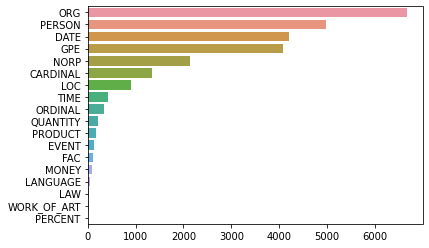

In [147]:
x,y=map(list,zip(*count))
sns.barplot(x=y,y=x)

#### NER for Organizations

In [148]:
def ner(text,ent="ORG"):
    doc=nlp(text)
    return [X.text for X in doc.ents if X.label_ == ent]

In [149]:
org=new["final"].apply(lambda x: ner(x))
org=[i for x in org for i in x]


C:\Users\Naim Cavin\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:>

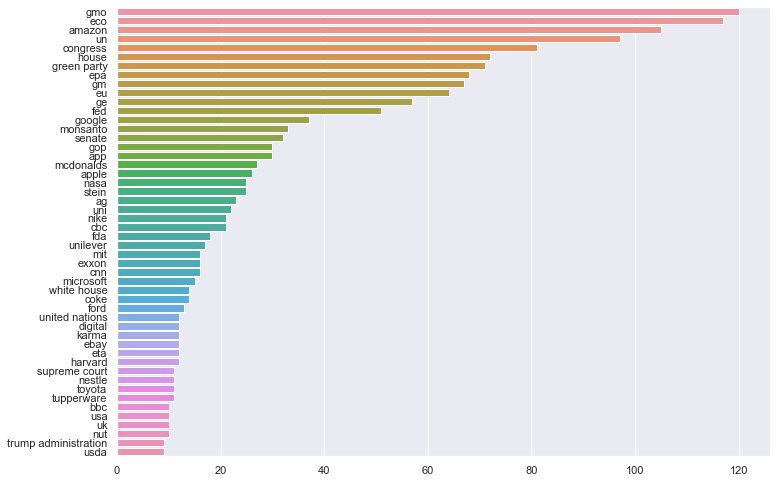

In [172]:
counter=Counter(org)
x,y=map(list,zip(*counter.most_common(50)))
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.barplot(y,x)

In [170]:
org = [i for i in org if i != "nah"]
org = [i for i in org if i != "kinda"]

In [175]:
org = [i for i in org if i != "green party"]
org = [i for i in org if i != "gmo"]
org = [i for i in org if i != "eco"]
org = [i for i in org if i != "un"]
org = [i for i in org if i != "congress"]
org = [i for i in org if i != "house"]
org = [i for i in org if i != "epa"]
org = [i for i in org if i != "eu"]
org = [i for i in org if i != "senate"]
org = [i for i in org if i != "gop"]
org = [i for i in org if i != "white house"]
org = [i for i in org if i != "digital"]
org = [i for i in org if i != "harvard"]
org = [i for i in org if i != "supreme court"]
org = [i for i in org if i != "app"]
org = [i for i in org if i != "nut"]
org = [i for i in org if i != "trump administration"]

C:\Users\Naim Cavin\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:>

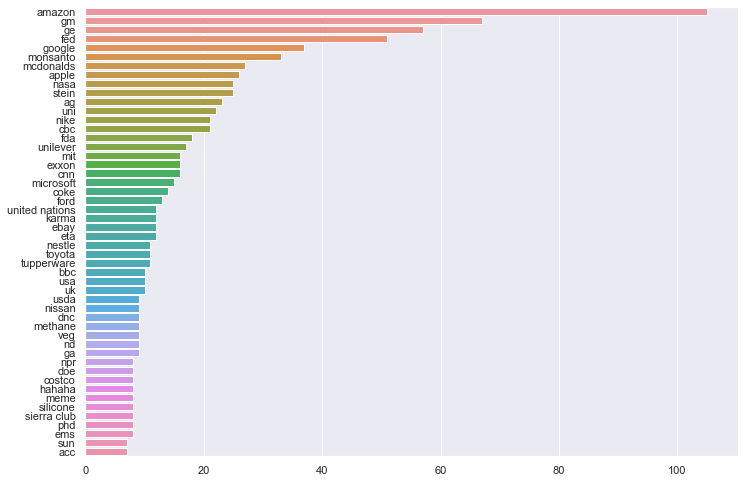

In [176]:
counter=Counter(org)
x,y=map(list,zip(*counter.most_common(50)))
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.barplot(y,x)

In [183]:
org = [i for i in org if i != "fed"]
org = [i for i in org if i != "stein"]
org = [i for i in org if i != "ag"]
org = [i for i in org if i != "uni"]
org = [i for i in org if i != "fda"]
org = [i for i in org if i != "mit"]
org = [i for i in org if i != "united nations"]
org = [i for i in org if i != "eta"]
org = [i for i in org if i != "karma"]
org = [i for i in org if i != "cbc"]
org = [i for i in org if i != "cnn"]
org = [i for i in org if i != "coke"]
org = [i for i in org if i != "bbc"]
org = [i for i in org if i != "tupperware"]
org = [i for i in org if i != "usa"]
org = [i for i in org if i != "uk"]
org = [i for i in org if i != "usda"]
org = [i for i in org if i != "methane"]
org = [i for i in org if i != "npr"]
org = [i for i in org if i != "hahaha"]
org = [i for i in org if i != "meme"]
org = [i for i in org if i != "nd"]
org = [i for i in org if i != "veg"]
org = [i for i in org if i != "dnc"]
org = [i for i in org if i != "ga"]
org = [i for i in org if i != "dnc"]
org = [i for i in org if i != "doe"]
org = [i for i in org if i != "silicone"]
org = [i for i in org if i != "sierra club"]
org = [i for i in org if i != "phd"]
org = [i for i in org if i != "ems"]

C:\Users\Naim Cavin\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:>

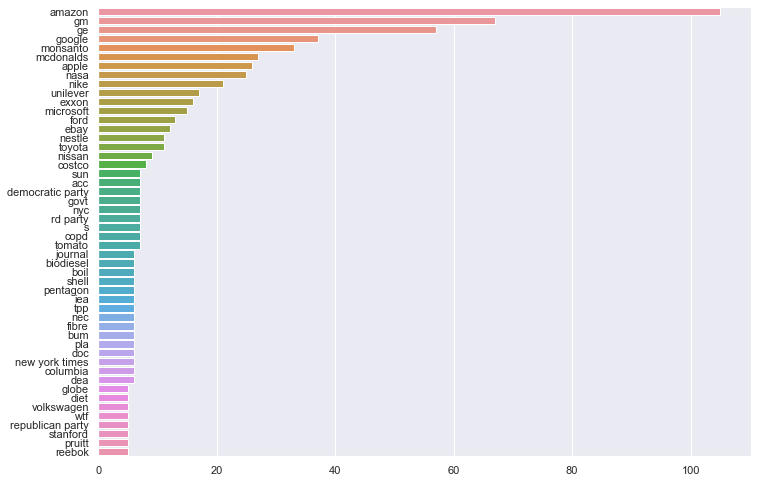

In [184]:
counter=Counter(org)
x,y=map(list,zip(*counter.most_common(50)))
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.barplot(y,x)

In [198]:
org = [i for i in org if i != "sun"]
org = [i for i in org if i != "acc"]
org = [i for i in org if i != "democratic party"]
org = [i for i in org if i != "govt"]
org = [i for i in org if i != "nyc"]
org = [i for i in org if i != "rd party"]
org = [i for i in org if i != "s"]
org = [i for i in org if i != "copd"]
org = [i for i in org if i != "tomato"]
org = [i for i in org if i != "journal"]
org = [i for i in org if i != "biodiesel"]
org = [i for i in org if i != "boil"]
org = [i for i in org if i != "pentagon"]
org = [i for i in org if i != "iea"]
org = [i for i in org if i != "tpp"]
org = [i for i in org if i != "nec"]
org = [i for i in org if i != "fibre"]
org = [i for i in org if i != "bum"]
org = [i for i in org if i != "pla"]
org = [i for i in org if i != "new york times"]
org = [i for i in org if i != "doc"]
org = [i for i in org if i != "columbia"]
org = [i for i in org if i != "dea"]
org = [i for i in org if i != "globe"]
org = [i for i in org if i != "diet"]
org = [i for i in org if i != "nasa"]
org = [i for i in org if i != "wtf"]
org = [i for i in org if i != "republican party"]
org = [i for i in org if i != "stanford"]
org = [i for i in org if i != "pruitt"]


C:\Users\Naim Cavin\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:>

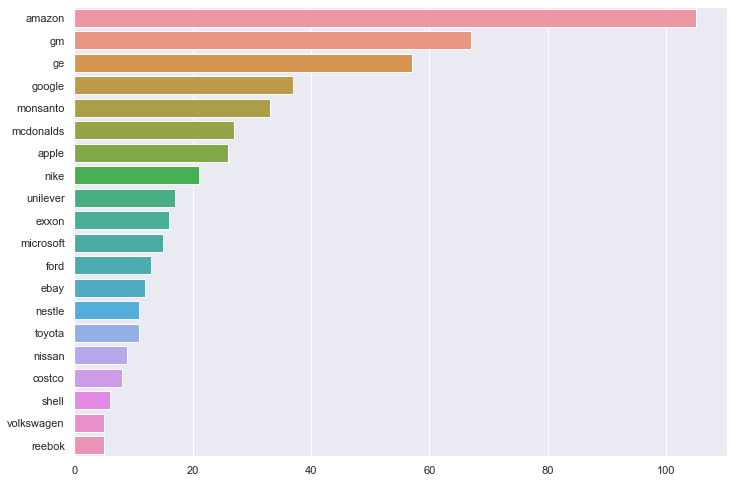

In [199]:
counter=Counter(org)
x,y=map(list,zip(*counter.most_common(20)))
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.barplot(y,x)

In [200]:
a = pd.DataFrame(data={'A': counter.most_common(20)})

In [201]:
a.head(50)

,A
0,"(amazon, 105)"
1,"(gm, 67)"
2,"(ge, 57)"
3,"(google, 37)"
4,"(monsanto, 33)"
5,"(mcdonalds, 27)"
6,"(apple, 26)"
7,"(nike, 21)"
8,"(unilever, 17)"
9,"(exxon, 16)"


### B) NLTK

In [18]:
sample1000=new.copy()

In [19]:
a= sample1000["final"].astype(str)

In [20]:
text = ""
for each in a:
    text = text+each

In [85]:
text

'alternative economic model needed native americans aboriginal australians indigenous peoples provide models thousands years work west colonized lands silenced erased ways living need new model listen voices princes ancestors conquered killed capitalism indigenous thoughtsplutters tea dude owns duchy cornwall sure hes somewhat environmentally friendly hes personally benefitted hugely business usualgarbage half necessarily correct spell hair correctly included petroleum wtf quit exploiting real issues push shitty bloghello thank comment dedicated learn strive ecofriendly lifestyle far perfect thought people interested learn way sorry feel unhappy misspelled word hair correct love learn blog week old best hoping better daysounds great wood wooden buildings look nice definitely increased fire risk hopefully good sprinkler system mitigate article point fire resistance clt wood experiments laminate damaged allow wood combust article uses example lighting match log showing log set fire silly

In [10]:
import nltk
from nltk.tokenize import word_tokenize
from nltk.tag import pos_tag

In [11]:
nltk.download('treebank')
sent = nltk.corpus.treebank.tagged_sents()

[nltk_data] Downloading package treebank to C:\Users\Naim
[nltk_data]     Cavin/nltk_data...
[nltk_data]   Package treebank is already up-to-date!


In [12]:
print(len(sent))
sent

3914


[[('Pierre', 'NNP'), ('Vinken', 'NNP'), (',', ','), ('61', 'CD'), ('years', 'NNS'), ('old', 'JJ'), (',', ','), ('will', 'MD'), ('join', 'VB'), ('the', 'DT'), ('board', 'NN'), ('as', 'IN'), ('a', 'DT'), ('nonexecutive', 'JJ'), ('director', 'NN'), ('Nov.', 'NNP'), ('29', 'CD'), ('.', '.')], [('Mr.', 'NNP'), ('Vinken', 'NNP'), ('is', 'VBZ'), ('chairman', 'NN'), ('of', 'IN'), ('Elsevier', 'NNP'), ('N.V.', 'NNP'), (',', ','), ('the', 'DT'), ('Dutch', 'NNP'), ('publishing', 'VBG'), ('group', 'NN'), ('.', '.')], ...]

In [13]:
print(nltk.ne_chunk(sent[0]))

(S
  (PERSON Pierre/NNP)
  (ORGANIZATION Vinken/NNP)
  ,/,
  61/CD
  years/NNS
  old/JJ
  ,/,
  will/MD
  join/VB
  the/DT
  board/NN
  as/IN
  a/DT
  nonexecutive/JJ
  director/NN
  Nov./NNP
  29/CD
  ./.)


In [14]:
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package punkt to C:\Users\Naim
[nltk_data]     Cavin/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\Naim Cavin/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [104]:
raw_text="""The Board of Control for Cricket in India (BCCI) is the governing body for cricket in India and is under the jurisdiction of Ministry of Youth Affairs and Sports, Government of India.[2] The board was formed in December 1928 as a society, registered under the Tamil Nadu Societies Registration Act. It is a consortium of state cricket associations and the state associations select their representatives who in turn elect the BCCI Chief. Its headquarters are in Wankhede Stadium, Mumbai. Grant Govan was its first president and Anthony De Mello its first secretary. """

In [15]:
raw_words= word_tokenize(text)
tags=pos_tag(raw_words)

In [16]:
nltk.download('maxent_ne_chunker')
nltk.download('words')

[nltk_data] Downloading package maxent_ne_chunker to C:\Users\Naim
[nltk_data]     Cavin/nltk_data...
[nltk_data]   Package maxent_ne_chunker is already up-to-date!
[nltk_data] Downloading package words to C:\Users\Naim
[nltk_data]     Cavin/nltk_data...
[nltk_data]   Package words is already up-to-date!


True

In [17]:
ne = nltk.ne_chunk(tags,binary=True)
print(ne)

(S
  alternative/JJ
  economic/JJ
  model/NN
  needed/VBD
  native/JJ
  americans/NNS
  aboriginal/JJ
  australians/NNS
  indigenous/JJ
  peoples/NNS
  provide/VBP
  models/NNS
  thousands/NNS
  years/NNS
  work/VBP
  west/RB
  colonized/VBN
  lands/NNS
  silenced/VBD
  erased/JJ
  ways/NNS
  living/VBG
  need/VBP
  new/JJ
  model/NN
  listen/JJ
  voices/NNS
  princes/NNS
  ancestors/NNS
  conquered/VBD
  killed/VBN
  capitalism/NN
  indigenous/JJ
  thoughtsplutters/NNS
  tea/VBP
  dude/JJ
  owns/VBZ
  duchy/VBP
  cornwall/JJ
  sure/JJ
  hes/NNS
  somewhat/RB
  environmentally/RB
  friendly/JJ
  hes/NNS
  personally/RB
  benefitted/VBN
  hugely/RB
  business/NN
  usualgarbage/JJ
  half/NN
  necessarily/RB
  correct/JJ
  spell/NN
  hair/NN
  correctly/RB
  included/VBD
  petroleum/NN
  wtf/NN
  quit/NN
  exploiting/VBG
  real/JJ
  issues/NNS
  push/VBP
  shitty/RB
  bloghello/JJ
  thank/JJ
  comment/NN
  dedicated/VBN
  learn/RBR
  strive/JJ
  ecofriendly/RB
  lifestyle/JJ
  far/RB
  pe

**For better understanding, we can use the IOB tagging format. This format provides tags similar to the pos tagging but gives clarification about the position and the entity of the words.**

- B-{CHUNK_TYPE} – for the word in the Beginning chunk

- I-{CHUNK_TYPE} – for words Inside the chunk

- O – Outside any chunk

In [18]:
from nltk.chunk import tree2conlltags
iob = tree2conlltags(ne)
iob

[('alternative', 'JJ', 'O'),
 ('economic', 'JJ', 'O'),
 ('model', 'NN', 'O'),
 ('needed', 'VBD', 'O'),
 ('native', 'JJ', 'O'),
 ('americans', 'NNS', 'O'),
 ('aboriginal', 'JJ', 'O'),
 ('australians', 'NNS', 'O'),
 ('indigenous', 'JJ', 'O'),
 ('peoples', 'NNS', 'O'),
 ('provide', 'VBP', 'O'),
 ('models', 'NNS', 'O'),
 ('thousands', 'NNS', 'O'),
 ('years', 'NNS', 'O'),
 ('work', 'VBP', 'O'),
 ('west', 'RB', 'O'),
 ('colonized', 'VBN', 'O'),
 ('lands', 'NNS', 'O'),
 ('silenced', 'VBD', 'O'),
 ('erased', 'JJ', 'O'),
 ('ways', 'NNS', 'O'),
 ('living', 'VBG', 'O'),
 ('need', 'VBP', 'O'),
 ('new', 'JJ', 'O'),
 ('model', 'NN', 'O'),
 ('listen', 'JJ', 'O'),
 ('voices', 'NNS', 'O'),
 ('princes', 'NNS', 'O'),
 ('ancestors', 'NNS', 'O'),
 ('conquered', 'VBD', 'O'),
 ('killed', 'VBN', 'O'),
 ('capitalism', 'NN', 'O'),
 ('indigenous', 'JJ', 'O'),
 ('thoughtsplutters', 'NNS', 'O'),
 ('tea', 'VBP', 'O'),
 ('dude', 'JJ', 'O'),
 ('owns', 'VBZ', 'O'),
 ('duchy', 'VBP', 'O'),
 ('cornwall', 'JJ', 'O'),
 ('

In [26]:
type(iob)

NameError: name 'iob' is not defined

In [20]:
iob_result = pd.DataFrame(iob, columns=["Word", "Tags","Chunk"])

In [21]:
iob_result.head()

,Word,Tags,Chunk
0,alternative,JJ,O
1,economic,JJ,O
2,model,NN,O
3,needed,VBD,O
4,native,JJ,O


In [22]:
iob_result.shape

(608911, 3)

In [31]:
import seaborn as sns
import numpy as np
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer
from collections import  Counter

In [29]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore",category=DeprecationWarning)

In [33]:
tags = [each_row for each_row in iob_result["Tags"]]
counter=Counter(tags)
count=counter.most_common()

<AxesSubplot:>

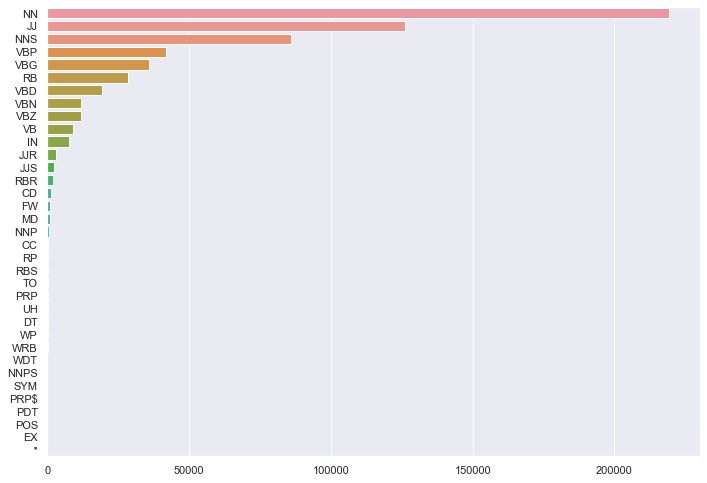

In [35]:
x,y=map(list,zip(*count))
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.barplot(x=y,y=x)

In [36]:
chunks = [each_row for each_row in iob_result["Chunk"]]
counter=Counter(chunks)
count=counter.most_common()

<AxesSubplot:>

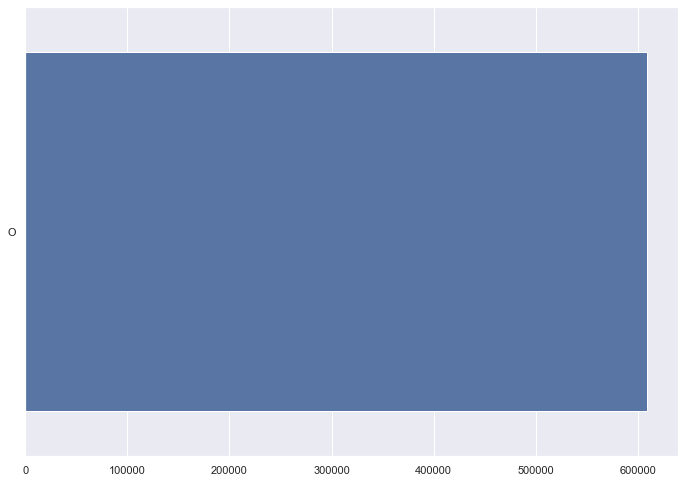

In [37]:
x,y=map(list,zip(*count))
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.barplot(x=y,y=x)

### D) STANFORD NER

In [1]:
import pandas as pd
new = pd.read_csv("Clean_Data_Before_Covid.csv")
print(new.shape)
new.head()

(31790, 2)


,id,final
0,ffbxc48,alternative economic model needed native ameri...
1,ffc5i6h,splutters tea dude owns duchy cornwall sure he...
2,ff8z7yf,garbage half necessarily correct spell hair co...
3,ff8znss,hello thank comment dedicated learn strive eco...
4,ff8i5we,sounds great wood wooden buildings look nice d...


In [2]:
text = "Apple acquired Zoom in China on Wednesday 6th May 2020.\
This news has made Apple and Google stock jump by 5% on Dow Jones Index in the \
United States of America"

In [7]:
import nltk
from nltk.tag import StanfordNERTagger
from nltk.tokenize import word_tokenize
import os

In [4]:
model = 'english.all.3class.distsim.crf.ser.gz'
jar = 'stanford-ner.jar'

In [5]:
st = StanfordNERTagger(model, jar,encoding='utf-8')

In [11]:
import os
java_path = "C:/Program Files/Java/jdk1.8.0_321/bin/java.exe"
os.environ['JAVAHOME'] = java_path

In [12]:
tokenized_text = nltk.word_tokenize(text)
classified_text = st.tag(tokenized_text)

In [13]:
classified_text_df = pd.DataFrame(classified_text)

In [15]:
classified_text_df

,0,1
0,Apple,ORGANIZATION
1,acquired,O
2,Zoom,O
3,in,O
4,China,LOCATION
5,on,O
6,Wednesday,O
7,6th,O
8,May,O
9,2020.This,O


In [16]:
classified_text_df.drop_duplicates(keep='first', inplace=True)
classified_text_df.reset_index(drop=True, inplace=True)
classified_text_df.columns = ["Entities", "Labels"]
classified_text_df

,Entities,Labels
0,Apple,ORGANIZATION
1,acquired,O
2,Zoom,O
3,in,O
4,China,LOCATION
5,on,O
6,Wednesday,O
7,6th,O
8,May,O
9,2020.This,O


In [17]:
tokenized_text = nltk.word_tokenize(text)
classified_text = st.tag(tokenized_text)

netagged_words = classified_text

entities = []
labels = []

from itertools import groupby
for tag, chunk in groupby(classified_text, lambda x:x[1]):
    if tag != "O":
        entities.append(' '.join(w for w, t in chunk))
        labels.append(tag)
        
        
entities_all = list(zip(entities, labels))
entities_unique = list(set(zip(entities, labels))) #unique entities   
entities_df = pd.DataFrame(entities_unique)
entities_df.columns = ["Entities", "Labels"]
entities_df

,Entities,Labels
0,Apple,ORGANIZATION
1,Google,ORGANIZATION
2,United States of America,LOCATION
3,China,LOCATION


In [21]:
tokenized_text = nltk.word_tokenize(text)
classified_text = st.tag(tokenized_text)

netagged_words = classified_text

entities = []
labels = []

from itertools import groupby
for tag, chunk in groupby(classified_text, lambda x:x[1]):
    if tag != "O":
        entities.append(' '.join(w for w, t in chunk))
        labels.append(tag)
        
        
entities_all = list(zip(entities, labels))
entities_unique = list(set(zip(entities, labels))) #unique entities   
entities_df = pd.DataFrame(entities_unique)
entities_df.columns = ["Entities", "Labels"]
entities_df

,Entities,Labels
0,justin brice guariglia,PERSON
1,house senate google,ORGANIZATION
2,democratic republican,ORGANIZATION
3,israel,LOCATION
4,india indonesia china,LOCATION
...,...,...
93,china east china,LOCATION
94,green party influential democratic party,ORGANIZATION
95,amsterdam,LOCATION
96,inglewood,LOCATION


In [22]:
entities_df[entities_df["Labels"] == "ORGANIZATION"]

,Entities,Labels
1,house senate google,ORGANIZATION
2,democratic republican,ORGANIZATION
7,amazon employees climate justice group,ORGANIZATION
8,republican democratic,ORGANIZATION
11,white house house representatives supreme court,ORGANIZATION
13,united states china,ORGANIZATION
16,republicans congress,ORGANIZATION
20,democratic party,ORGANIZATION
24,allies congress,ORGANIZATION
27,republican party,ORGANIZATION


In [23]:
entities_df[entities_df["Labels"] == "LOCATION"]

,Entities,Labels
3,israel,LOCATION
4,india indonesia china,LOCATION
5,europe america,LOCATION
10,america,LOCATION
12,china south korea,LOCATION
14,argentina,LOCATION
15,washington california minnesota,LOCATION
18,united states city,LOCATION
19,europe china,LOCATION
22,germany,LOCATION


In [24]:
entities_df[entities_df["Labels"] == "PERSON"]

,Entities,Labels
0,justin brice guariglia,PERSON
6,obama,PERSON
9,jackie trad,PERSON
17,james shaw,PERSON
21,jaci anderson,PERSON
25,hillary clinton,PERSON
26,charles,PERSON
29,chris garrard,PERSON
41,chris morris,PERSON
50,kowalski,PERSON
